<a href="https://colab.research.google.com/github/shrey802/PPE-YOLOv9/blob/main/Train_YOLOv9_PPE.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

#**Step 01: Clone the YOLOv9 Github Repo**

In [1]:
!git clone https://github.com/WongKinYiu/yolov9.git

Cloning into 'yolov9'...
remote: Enumerating objects: 781, done.
remote: Counting objects: 100% (407/407), done.
remote: Compressing objects: 100% (168/168), done.
remote: Total 781 (delta 280), reused 276 (delta 227), pack-reused 374 (from 1)
Receiving objects: 100% (781/781), 3.30 MiB | 20.98 MiB/s, done.
Resolving deltas: 100% (325/325), done.


#**Step 02: Change Current Directory**

In [2]:
%cd yolov9

/content/yolov9


#**Step 03: Install All the Required Packages**

In [3]:
!pip install -r requirements.txt -q

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 207.3/207.3 kB 8.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 62.7/62.7 kB 80.1 kB/s eta 0:00:00


#**Step 04: Download the Model Weights**

**NOTE:** In the YOLOv9 paper, versions yolov9-s and yolov9-m are also mentioned, but the weights for these models are not yet available in the YOLOv9 repository.

In [4]:
import os
HOME = os.getcwd()
print(HOME)

/content/yolov9


In [5]:
!mkdir -p {HOME}/weights

In [6]:
!wget -P {HOME}/weights -q https://github.com/WongKinYiu/yolov9/releases/download/v0.1/yolov9-c.pt
!wget -P {HOME}/weights -q https://github.com/WongKinYiu/yolov9/releases/download/v0.1/yolov9-e.pt

In [7]:
!ls -la {HOME}/weights

total 237684
drwxr-xr-x  2 root root      4096 Aug 24 15:21 .
drwxr-xr-x 13 root root      4096 Aug 24 15:21 ..
-rw-r--r--  1 root root 103153312 Feb 18  2024 yolov9-c.pt
-rw-r--r--  1 root root 140217688 Feb 18  2024 yolov9-e.pt


#**Step 05: Download the Dataset from Roboflow**

In [8]:
!pip install roboflow

from roboflow import Roboflow
rf = Roboflow(api_key="8joVH7TL2k5V6uScFBEy")
project = rf.workspace("project-uyrxf").project("ppe_detection-v1x3l")
version = project.version(2)
dataset = version.download("yolov9")


   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 79.8/79.8 kB 5.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 54.5/54.5 kB 4.5 MB/s eta 0:00:00
loading Roboflow workspace...
loading Roboflow project...



Extracting Dataset Version Zip to PPE_Detection-2 in yolov9:: 100%|██████████| 6472/6472 [00:01<00:00, 5431.27it/s]


#**Step 06: Train Custom Model**

In [9]:
%cd yolov9

[Errno 2] No such file or directory: 'yolov9'
/content/yolov9


In [12]:
!python train_dual.py --workers 8 --device 0 --batch 8 --data 'PPE_Detection-2/data.yaml' --img 640 --cfg models/detect/yolov9-e.yaml --weights '{HOME}/weights/yolov9-e.pt' --name yolov9-e-finetuning --hyp hyp.scratch-high.yaml --min-items 0 --epochs 30 --close-mosaic 15


2024-08-24 18:07:04.484055: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:485] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2024-08-24 18:07:04.505016: E external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:8454] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
2024-08-24 18:07:04.511098: E external/local_xla/xla/stream_executor/cuda/cuda_blas.cc:1452] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
2024-08-24 18:07:04.526171: I tensorflow/core/platform/cpu_feature_guard.cc:210] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: AVX2 FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags.
2024-08-24 18:07:05.879317: W tensorflow/compiler/tf2

#**Download Weights From the Drive**

In [13]:
!gdown "https://drive.google.com/uc?id=140oaWpcxsbZM9glqzeUYHR5gQT_wERX6&confirm=t"

Downloading...
From: https://drive.google.com/uc?id=140oaWpcxsbZM9glqzeUYHR5gQT_wERX6&confirm=t
To: /content/yolov9/best.pt
100% 140M/140M [00:04<00:00, 33.6MB/s]


##**Step 07: Examine Training Results**

**NOTE:** By default, the results of each subsequent training sessions are saved in `{HOME}/yolov9/runs/train/`, in directories named `exp`, `exp2`, `exp3`, ... You can override this behavior by using the `--name` parameter.

In [23]:
!ls {HOME}/runs/train/yolov9-e-finetuning3

events.out.tfevents.1724522827.31058e2a94c6.44134.0  hyp.yaml  opt.yaml  weights


In [24]:
from IPython.display import Image

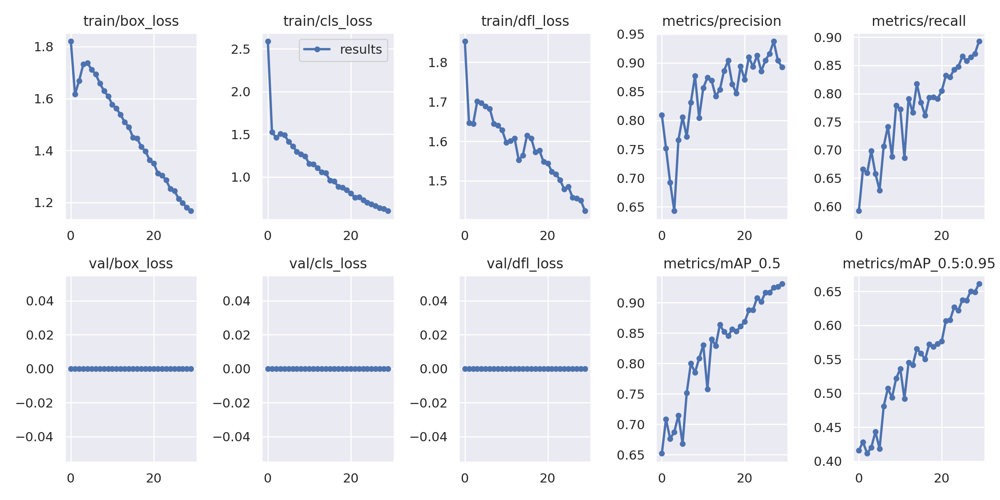

In [26]:
Image(filename=f"{HOME}/runs/train/yolov9-e-finetuning/results.png", width=1000)

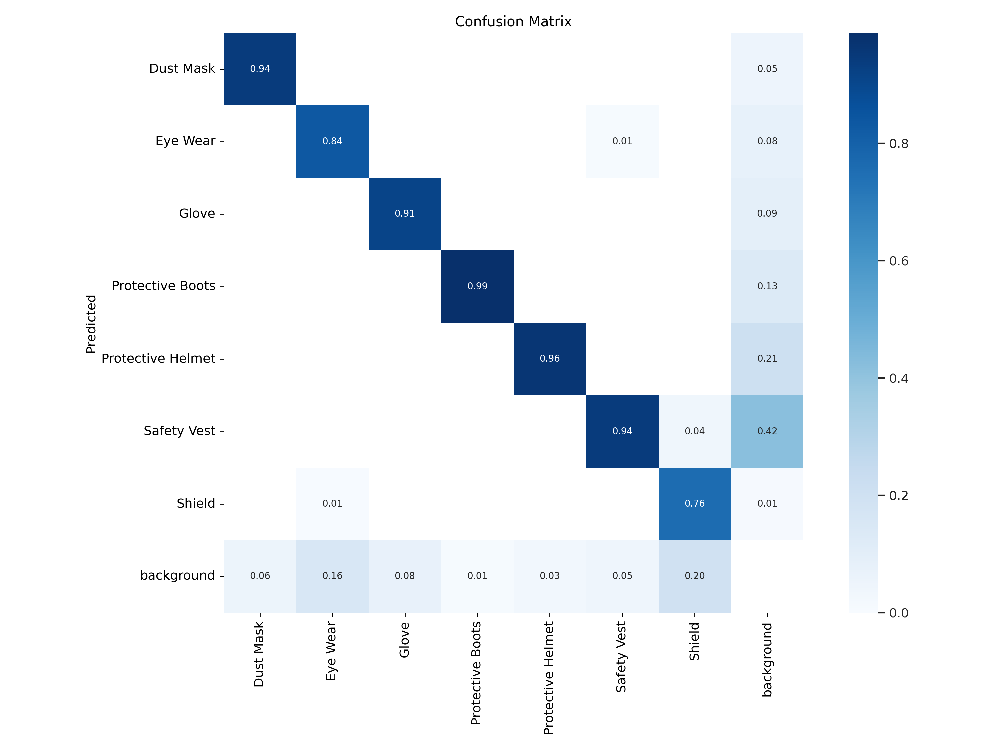

In [27]:
Image(filename=f"{HOME}/runs/train/yolov9-e-finetuning/confusion_matrix.png", width=1000)

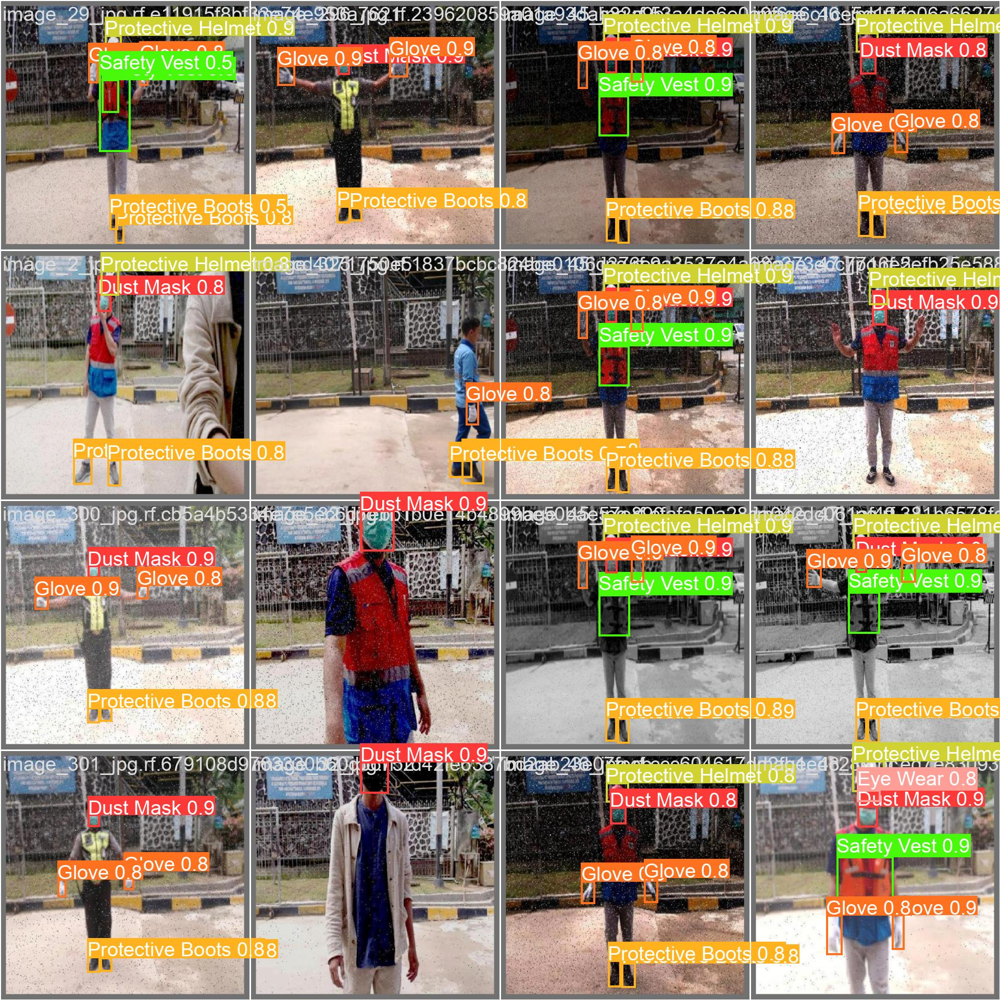

In [30]:
Image(filename=f"{HOME}/runs/train/yolov9-e-finetuning/val_batch2_pred.jpg", width=1000)

#**Step 08: Validate Custom Model**

In [32]:
# evaluate yolov9 models
!python val_dual.py --data 'PPE_Detection-2/data.yaml' --img 640 --batch 16 --conf 0.001 --iou 0.7 --device 0 --weights 'best.pt' --save-json --name yolov9_ppe_c_640_val


val_dual: data=PPE_Detection-2/data.yaml, weights=['best.pt'], batch_size=16, imgsz=640, conf_thres=0.001, iou_thres=0.7, max_det=300, task=val, device=0, workers=8, single_cls=False, augment=False, verbose=False, save_txt=False, save_hybrid=False, save_conf=False, save_json=True, project=runs/val, name=yolov9_ppe_c_640_val, exist_ok=False, half=False, dnn=False, min_items=0
YOLO 🚀 v0.1-104-g5b1ea9a Python-3.10.12 torch-2.3.1+cu121 CUDA:0 (Tesla T4, 15102MiB)

Fusing layers... 
yolov9-e summary: 839 layers, 68557066 parameters, 0 gradients, 240.7 GFLOPs
val: Scanning /content/yolov9/PPE_Detection-2/valid/labels.cache... 637 images, 0 backgrounds, 0 corrupt: 100% 637/637 [00:00<?, ?it/s]
                 Class     Images  Instances          P          R      mAP50   mAP50-95: 100% 40/40 [00:56<00:00,  1.41s/it]
                   all        637       3064      0.886       0.89      0.919      0.642
             Dust Mask        637        308      0.935      0.927      0.964      0.681


#**Step 09: Download the Demo Videos**

In [33]:
!gdown "https://drive.google.com/uc?id=1Nyl18zr7zOJHh8uHtSic3dsJSY4LI_t-&confirm=t"

Downloading...
From: https://drive.google.com/uc?id=1Nyl18zr7zOJHh8uHtSic3dsJSY4LI_t-&confirm=t
To: /content/yolov9/PPE_Part1.mp4
100% 14.2M/14.2M [00:00<00:00, 32.7MB/s]


In [34]:
!gdown "https://drive.google.com/uc?id=1SxcrDanPAr-PZfJjWBxoa2t8lUSM2dZn&confirm=t"

Downloading...
From: https://drive.google.com/uc?id=1SxcrDanPAr-PZfJjWBxoa2t8lUSM2dZn&confirm=t
To: /content/yolov9/PPE_Part2.mp4
100% 11.1M/11.1M [00:00<00:00, 29.2MB/s]


#**Step 10: Inference on Image**

In [35]:
# inference yolov9 models
!python detect_dual.py --source 'PPE_Detection-2/valid/images/85_jpg.rf.bb831a912c797ce2a13ad85fe9e6094e.jpg' --img 640 --device 0 --weights 'best.pt' --name yolov9_c_ppe_640_detect


detect_dual: weights=['best.pt'], source=PPE_Detection-2/valid/images/85_jpg.rf.bb831a912c797ce2a13ad85fe9e6094e.jpg, data=data/coco128.yaml, imgsz=[640, 640], conf_thres=0.25, iou_thres=0.45, max_det=1000, device=0, view_img=False, save_txt=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs/detect, name=yolov9_c_ppe_640_detect, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False, vid_stride=1
YOLO 🚀 v0.1-104-g5b1ea9a Python-3.10.12 torch-2.3.1+cu121 CUDA:0 (Tesla T4, 15102MiB)

Fusing layers... 
yolov9-e summary: 839 layers, 68557066 parameters, 0 gradients, 240.7 GFLOPs
image 1/1 /content/yolov9/PPE_Detection-2/valid/images/85_jpg.rf.bb831a912c797ce2a13ad85fe9e6094e.jpg: 640x640 1 Protective Helmet, 1 Safety Vest, 116.5ms
Speed: 0.6ms pre-process, 116.5ms inference, 543.2ms NMS per image at shape (1, 3, 640, 640)
Results saved to runs/detect/yolov9_

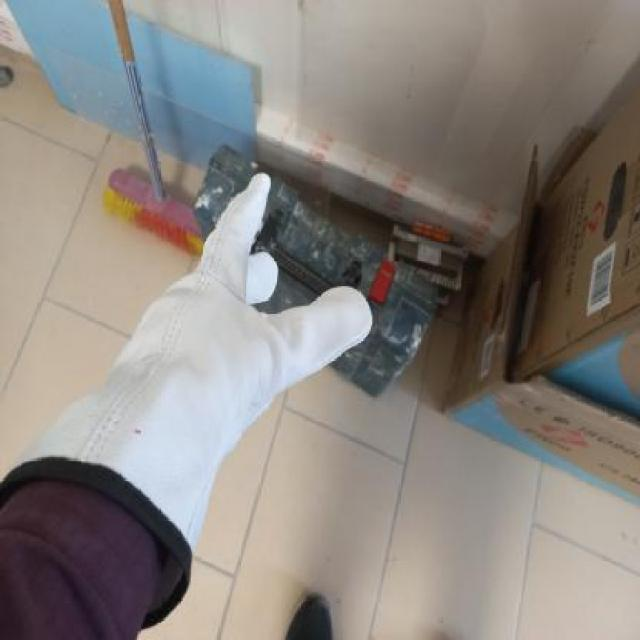

In [37]:
Image(filename=f"{HOME}/PPE_Detection-2/test/images/20220721_161946_jpg.rf.905c375aa964159f9edab2a55a6e7476.jpg")

#**Step 11: Inference on Video**

In [38]:
# inference yolov9 models
!python detect_dual.py --source 'PPE_Part1.mp4' --img 640 --device 0 --weights 'best.pt' --name yolov9_ppe_640_detect


detect_dual: weights=['best.pt'], source=PPE_Part1.mp4, data=data/coco128.yaml, imgsz=[640, 640], conf_thres=0.25, iou_thres=0.45, max_det=1000, device=0, view_img=False, save_txt=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs/detect, name=yolov9_ppe_640_detect, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False, vid_stride=1
YOLO 🚀 v0.1-104-g5b1ea9a Python-3.10.12 torch-2.3.1+cu121 CUDA:0 (Tesla T4, 15102MiB)

Fusing layers... 
yolov9-e summary: 839 layers, 68557066 parameters, 0 gradients, 240.7 GFLOPs
video 1/1 (1/310) /content/yolov9/PPE_Part1.mp4: 384x640 2 Protective Helmets, 5 Safety Vests, 146.5ms
video 1/1 (2/310) /content/yolov9/PPE_Part1.mp4: 384x640 2 Protective Helmets, 5 Safety Vests, 55.7ms
video 1/1 (3/310) /content/yolov9/PPE_Part1.mp4: 384x640 2 Protective Helmets, 5 Safety Vests, 56.0ms
video 1/1 (4/310) /content/yolov9/PPE_Par

#**Display the Output Video**

In [39]:
!rm '/content/result_compressed.mp4'

rm: cannot remove '/content/result_compressed.mp4': No such file or directory


In [40]:
from IPython.display import HTML
from base64 import b64encode
import os

# Input video path
save_path = 'runs/detect/yolov9_ppe_640_detect/PPE_Part1.mp4'

# Compressed video path
compressed_path = "/content/result_compressed.mp4"

os.system(f"ffmpeg -i {save_path} -vcodec libx264 {compressed_path}")

# Show video
mp4 = open(compressed_path,'rb').read()
data_url = "data:video/mp4;base64," + b64encode(mp4).decode()
HTML("""
<video width=400 controls>
      <source src="%s" type="video/mp4">
</video>
""" % data_url)

In [41]:
# inference yolov9 models
!python detect_dual.py --source 'PPE_Part2.mp4' --img 640 --device 0 --weights 'best.pt' --name yolov9_ppe_640_detect2


detect_dual: weights=['best.pt'], source=PPE_Part2.mp4, data=data/coco128.yaml, imgsz=[640, 640], conf_thres=0.25, iou_thres=0.45, max_det=1000, device=0, view_img=False, save_txt=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs/detect, name=yolov9_ppe_640_detect2, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False, vid_stride=1
YOLO 🚀 v0.1-104-g5b1ea9a Python-3.10.12 torch-2.3.1+cu121 CUDA:0 (Tesla T4, 15102MiB)

Fusing layers... 
yolov9-e summary: 839 layers, 68557066 parameters, 0 gradients, 240.7 GFLOPs
video 1/1 (1/267) /content/yolov9/PPE_Part2.mp4: 384x640 (no detections), 148.7ms
video 1/1 (2/267) /content/yolov9/PPE_Part2.mp4: 384x640 1 Protective Helmet, 2 Safety Vests, 63.3ms
video 1/1 (3/267) /content/yolov9/PPE_Part2.mp4: 384x640 1 Protective Helmet, 2 Safety Vests, 64.5ms
video 1/1 (4/267) /content/yolov9/PPE_Part2.mp4: 384x640 2 Safe

#**Display the Output Video**

In [ ]:
!rm '/content/result_compressed.mp4'

In [42]:
from IPython.display import HTML
from base64 import b64encode
import os

# Input video path
save_path = 'runs/detect/yolov9_ppe_640_detect2/PPE_Part2.mp4'

# Compressed video path
compressed_path = "/content/result_compressed.mp4"

os.system(f"ffmpeg -i {save_path} -vcodec libx264 {compressed_path}")

# Show video
mp4 = open(compressed_path,'rb').read()
data_url = "data:video/mp4;base64," + b64encode(mp4).decode()
HTML("""
<video width=400 controls>
      <source src="%s" type="video/mp4">
</video>
""" % data_url)

In [ ]:
!python detect_dual.py --source '.mp4' --img 640 --device 0 --weights 'best.pt' --name yolov9_ppe_640_detect2

In [44]:
trained_model_path = 'best.pt'
from google.colab import files

# Download the YOLO model file
files.download(trained_model_path)


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>